In [1]:
import warnings
warnings.filterwarnings("ignore")

import sys
sys.path.insert(0,'/home/zhr/fastai1')


from fastai.vision import *
from fastai import *
from fastai.callbacks import *
__version__

path = Path('/home/helen/dataset/pascal_2007')
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu') 

trn_im_names, trn_truths = get_annotations(path/'train.json')
val_im_names, val_truths = get_annotations(path/'valid.json')
tst_im_names, tst_truths = get_annotations(path/'test.json') 

tot_im_names, tot_truths = [trn_im_names + val_im_names, trn_truths + val_truths]
# Create a dictionary containing the composite of the above
img_y_dict = dict(zip(tot_im_names, tot_truths))
# Define a function, based on the dictionary created above, to use in a Fastai Data Block to structure the input data
truth_data_func = lambda o: img_y_dict[o.name]

sz=224       # Image size
bs=64        # Batch size

np.random.seed(35) # cutout,在图像上随机挖几个洞；
tfms = get_transforms(cutout(n_holes=(1,4), length=(10, 160), p=.5), max_rotate=4., max_zoom=1.1, p_affine=0.5, p_lighting=0.5 )
data = (ObjectItemList
        .from_folder(path/'train')#get_files->ImageList
        .split_by_rand_pct(0.02)#->ItemLists
        .label_from_func(truth_data_func) # ->LabelLists
        .transform(tfms=[],size=sz,tfm_y=True,resize_method=ResizeMethod.SQUISH)
        .databunch(bs=bs,collate_fn=bb_pad_collate,num_workers=16,pin_memory=False)#->ImageDataBunch
        .normalize(imagenet_stats)
       )

# Filter out all zero-valued bounding boxes
def un_pad(boxes,labels):
    bb_keep = ((boxes[:,2] - boxes[:,0])>0).nonzero()[:,0]
    return boxes[bb_keep],labels[bb_keep]

# Calculate the area of a bounding box
def box_area(boxes):
    return (boxes[:,2] - boxes[:,0]) * (boxes[:,3] - boxes[:,1])

# Calculate the intersection of two given bounding boxes
def intersect(box_a,box_b):
    #make sure box_a and box_b exists, otherwise undefine behavior if you call the func
    top_left = torch.max(box_a[:,None,:2],box_b[None,:,:2])
    bot_right = torch.min(box_a[:,None,2:],box_b[None,:,2:])
    inter = torch.clamp((bot_right - top_left),min=0)
    return inter[:,:,0] * inter[:,:,1]

# Calculate Jaccard (IOU)
def iou(bbox,anchor):
    #bbox is gt_bb, anchor is anchor box, all in fastai style
    if len(bbox.shape) == 1: bbox = bbox[None,...]
    inter = intersect(bbox,anchor)
    union = box_area(bbox).unsqueeze(dim=1) + box_area(anchor).unsqueeze(dim=0) - inter #to broadcast shape to (N,16),where N is number of gt_bb for single image
    return inter / union

# Display generated anchor grid
def show_anchors(ancs, size):
    _,ax = plt.subplots(1,1, figsize=(5,5))
    ax.set_xticks(np.linspace(-1,1, size[1]+1))
    ax.set_yticks(np.linspace(-1,1, size[0]+1))
    ax.grid(True, which='both')
    ax.scatter(ancs[:,1], ancs[:,0]) #y is first
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    ax.set_xlim(-1,1)
    ax.set_ylim(1,-1) #-1 is top, 1 is bottom
    for i, (x, y) in enumerate(zip(ancs[:, 1], ancs[:, 0])): ax.annotate(i, xy = (x,y))

#convert center/height/width to fastai top left and bottom right coordinates
def cthw2corners(boxes):
    top = (boxes[:,0] - boxes[:,2]/2).view(-1,1)
    left = (boxes[:,1] - boxes[:,3]/2).view(-1,1)
    bot = (boxes[:,0] + boxes[:,2]/2).view(-1,1)
    right = (boxes[:,1] + boxes[:,3]/2).view(-1,1)
    return torch.cat([top,left,bot,right],dim=1)

# Transform activations to bounding box format
def act_to_bbox(activation,anchor):
    activation = torch.tanh(activation) #force scale to be -1,1
    act_center = anchor[:,:2] + (activation[:,:2]/2 * grid_sizes.float().to(activation.device))
    act_hw = anchor[:,2:] * (activation[:,2:]/2 + 1)
    return cthw2corners(torch.cat([act_center,act_hw],dim=1))

  # Map to Ground Truth
def map_to_gt(overlaps):
    prior_overlap,prior_idx = overlaps.max(dim=1)#沿着行计算最大的先验框。
    sec_overlap,sec_idx = overlaps.max(dim=0)
    sec_overlap[prior_idx] = 4.99
    for i,o in enumerate(prior_idx): 
        sec_idx[o] = i
    return sec_overlap,sec_idx

anc_grids = [4, 2, 1]
anc_zooms = [0.75, 1., 1.3]
anc_ratios = [(1., 1.), (1., 0.5), (0.5, 1.)]

anchor_scales = [(anz*i,anz*j) for anz in anc_zooms 
                                    for (i,j) in anc_ratios]
# *** Number of Anchor Scales
k = len(anchor_scales)
# ***************************

anc_offsets = [2/(o*2) for o in anc_grids] #2 is the h,w in fastai 1.0 (-1,1)
anc_x = np.concatenate([np.repeat(np.linspace(ao-1, 1-ao, ag), ag)
                        for ao,ag in zip(anc_offsets,anc_grids)])
anc_y = np.concatenate([np.tile(np.linspace(ao-1, 1-ao, ag), ag)
                        for ao,ag in zip(anc_offsets,anc_grids)])
anc_ctrs = np.repeat(np.stack([anc_x,anc_y], axis=1), k, axis=0)
anc_sizes = np.concatenate([np.array([[2*o/ag,2*p/ag] 
              for i in range(ag*ag) for o,p in anchor_scales])
                 for ag in anc_grids]) #2/grid * scale,2 is the h,w in fastai 1.0
grid_sizes = tensor(np.concatenate([np.array([ 1/ag 
              for i in range(ag*ag) for o,p in anchor_scales])
                  for ag in anc_grids])).unsqueeze(1) *2 #again fastai 1.0 h,w is 2
anchors = tensor(np.concatenate([anc_ctrs, anc_sizes], axis=1)).float()
anchor_cnr = cthw2corners(anchors)

def is_unfreeze(learner):
    '''
    Determines whether the next-to-last layer in the model is set to unfreeze or freeze
    '''
    c = 0
    for each in list(learner.model.body[-1][0].parameters()):
      if each.requires_grad: c += 1   
    if c == len(list(learner.model.body[-1][0].parameters())):
      return True 
    else:
      return False
  
def find_optimal_lr(learner, noise=5, show_df=None, show_min_values=False):
    '''
    Parameters
    
      learner:  The learner (mandatory)
      
      (Optional)
      noise:   Filtering parameter, set to 5. Suggest no to modify this value
      
      show_df: 'head' - Show the top 50 rows, 
               'tail' - Show the tail 50 rows
    
      show_min_values: True  - Display all values, min, and max 
                       False - Display min_loss and max_grad values
    
    Returns:
      optimun_lr - if freeze = True
      Suggested Best Slice - if freeze = False
      
    Author:  J. Adolfo Villalobos @ 2019  
    '''
    
    # Get loss values, corresponding gradients, and lr values from model.recorder
    loss = np.array(learner.recorder.losses)
    loss_grad = np.gradient(loss)   
    # Transform lrs list to np array
    lrs = np.array(learner.recorder.lrs, dtype='float32')
    
    # Create a DataFrame with the data
    data = {'loss': loss.T, 'loss_grad': loss_grad.T, 'lrs': lrs.T}
    df = pd.DataFrame(data, columns=['loss', 'loss_grad', 'lrs', 'min_loss', 'max_loss', 'min_grad', 'max_grad'])
      
    # Populate "min" and "max" columns for loss and gradient values filtering the noise with argrelextrema.     
    from scipy.signal import argrelextrema
    
    #********
    # IMPORTANT: n filters noise (sharp spikes in the data). Higher n value filters noise more aggressively. 
    # n = 5 seems to work best
    n=noise    
    #********
    
    df.min_loss = df.iloc[argrelextrema(df.loss.values, np.less_equal, order=n)[0]]['loss']
    df.max_loss = df.iloc[argrelextrema(df.loss.values, np.greater_equal, order=n)[0]]['loss']
    df.min_grad = df.iloc[argrelextrema(df.loss_grad.values, np.less_equal, order=n)[0]]['loss_grad']
    df.max_grad = df.iloc[argrelextrema(df.loss_grad.values, np.greater_equal, order=n)[0]]['loss_grad']

    # Optional: Display dataframe if show_df=True
    if show_df == 'head': print(df.head(50)) 
    elif show_df == 'tail': print(df.tail(50))     
        
    # Plot losses and loss gradients against lr values
    plt.figure(figsize=[8, 5])
    #figs, ax = plt.subplots(1,1)
    ax = plt.gca()
    color_loss = 'blue'
    color_grad = 'orange'
    color_green = 'green'
    color_red = 'red'

    ax.xaxis.grid(True)
    ax.set_ylabel('Loss')
    ax.set_title('Learn Rate Finder')
    ax.tick_params(axis='y', labelcolor=color_loss)
    ax.semilogx(df.lrs, df.loss, c=color_loss )
    
    # Define variable vertical size of the plot window, depending on the graph shape
    u_limit = max(df.loss.loc[(df.lrs < 0.1)].max(), 250)*2    
    ax.set_ylim([-200, u_limit])
   
    # Plot resulting line graphs
    ax2 = ax.twinx()
    ax2.set_ylabel('loss', color= color_grad)
    ax2.semilogx(df.lrs, df.loss_grad, c = color_grad)
    ax2.tick_params(axis='y', labelcolor = color_grad)
    
    # plot inflection points
    ax.scatter(df.lrs, df.min_loss, c = color_red)    
    ax2.scatter(df.lrs, df.min_grad, c = color_red)    
    if show_min_values:
      ax.scatter(df.lrs, df.max_loss, c = color_green)
      ax2.scatter(df.lrs, df.max_grad, c = color_green) 
    
    # Legends
    # Legends
    plt.LogFormatter(labelOnlyBase=False)
    ax.legend(labels=['loss','min_loss'], loc='upper center', bbox_to_anchor=(0.5, 1.0), ncol=3, fancybox=True, shadow=True)
    ax2.legend(labels=['loss_grad','min_grad'], loc='upper center', bbox_to_anchor=(0.5, 0.9), ncol=3, fancybox=True, shadow=True)
    plt.show()
    
    # Display resulting lr values, format varies depending of the state of the model's 
    # next-to-last layer ggroup: set to freeze or unfreeze    
    if is_unfreeze(learn):
      # Yellow min_grad graph
      rev_tru_idx = df.min_grad.notna()[::-1]   
      optimun_lr_upper_bound_g = df.lrs.iloc[rev_tru_idx.idxmax()] 
      rev_tru_idx[rev_tru_idx.idxmax()] = False      
      optimun_lr_lower_bound_1_g = df.lrs.iloc[rev_tru_idx.idxmax()]
      rev_tru_idx[rev_tru_idx.idxmax()] = False      
      optimun_lr_lower_bound_2_g = df.lrs.iloc[rev_tru_idx.idxmax()] 
      
      # Blue loss graph
      rev_tru_idx_loss = df.min_loss.notna()[::-1]   
      optimun_lr_upper_bound_l = df.lrs.iloc[rev_tru_idx_loss.idxmax()] 
      rev_tru_idx_loss[rev_tru_idx_loss.idxmax()] = False      
      optimun_lr_lower_bound_1_l = df.lrs.iloc[rev_tru_idx_loss.idxmax()]
      rev_tru_idx_loss[rev_tru_idx_loss.idxmax()] = False     
      optimun_lr_lower_bound_2_l = df.lrs.iloc[rev_tru_idx_loss.idxmax()] 
      
      # Print results and return choices of lr slice
      print('Model set to: "unfreeze" or "freeze_to:"')      
      data = {'*Gradient - Orange Graph*' : [optimun_lr_upper_bound_g, optimun_lr_lower_bound_1_g, optimun_lr_lower_bound_2_g], 
              '*Loss - Blue Graph*' : [optimun_lr_upper_bound_l, optimun_lr_lower_bound_1_l, optimun_lr_lower_bound_2_l]}
      prdf = pd.DataFrame(data, index = ['First choice lr:', 'Second choice lr:', 'Third choice lr:' ])
      pd.options.display.float_format = '{:.10E}'.format
      #prdf.style.applymap('color: %s' % color_grad, subset=['*Gradient - Orange Graph*'])
      print(prdf)
       
      return optimun_lr_lower_bound_1_g, optimun_lr_upper_bound_g
      
    else:
        
      optimun_lr_upper_bound = df.lrs.iloc[df.min_grad.notna()[::-1].idxmax()]
      optimun_lr_lower_bound = df.lrs.iloc[df.min_loss.notna()[::-1].idxmax()]/10
      # Print results and return optimal lr
      print('Model set to "freeze":')
      print('  Optimun lr: {:.10E} '.format(optimun_lr_upper_bound))
      print('  Min loss divided by 10: {:.10E}'.format(optimun_lr_lower_bound))
      return optimun_lr_upper_bound 

# model 
f_model = models.resnet34

def y_handoff (x,k):
    # Reshape ssd output to match truth's shape 
    # Must return size of bs,r*c,nf
    # y structure is (16,4),(16,21) single item style
    bs,nf,row,col = x.shape
    x = x.view(bs,nf//k,-1)
    return x.permute(0,2,1)
    

# Standard convolution with stride=2 to halve the size of the image
class conv2_std_layer(nn.Module):
    def __init__(self, ni, nf, stride=2, drop=0.1):
        super().__init__()
        self.cnv = conv_layer(ni, nf, stride=stride)
        self.drp = nn.Dropout(drop)
        
    def forward(self, x):
        return self.drp(self.cnv(x))

# SSD convolution that camptures bounding box and class
class conv2_ssd_layer(nn.Module):
    def __init__(self, ni, k, no_cls):
        super().__init__()
        self.k = k 
        self.conv_class = conv2d(ni, no_cls*self.k, bias=True)
        self.conv_bbox = conv2d(ni, 4*self.k, bias=True)
        #self.conv_class.bias.data.zero_().add_(bias)
    
    def forward(self, x):
        label = self.conv_class(x)
        box = self.conv_bbox(x)
        return [y_handoff(box, self.k), y_handoff(label, self.k)]

class ssd_model(nn.Module):
    def __init__(self, arch=models.resnet34, k=9 , drop=0.4, no_cls=21):
        super().__init__()
        self.k = k
        self.body = create_body(arch)
        self.drop = nn.Dropout(0.2)   # it was 0.25

        self.std_conv_0 = conv2_std_layer(num_features_model(self.body), 256, drop=drop,stride=1)
        # Dimension-reducing  layers
        self.std_conv_1 = conv2_std_layer(256, 256, drop=drop, stride=2) # 4 by 4 layer
        self.std_conv_2 = conv2_std_layer(256, 256, drop=drop, stride=2) # 2 by 2 layer
        self.std_conv_3 = conv2_std_layer(256, 256, drop=drop, stride=2) # 1 by 1 layer
        # Standard layers
        self.ssd_conv_1 = conv2_ssd_layer(256, k=self.k, no_cls=no_cls)
        self.ssd_conv_2 = conv2_ssd_layer(256, k=self.k, no_cls=no_cls)
        self.ssd_conv_3 = conv2_ssd_layer(256, k=self.k, no_cls=no_cls)
        
    def forward(self, xb):
        xb = self.drop(F.relu(self.body(xb)))
        xb = self.std_conv_0(xb)
        xb = self.std_conv_1(xb)
        bb1, cls1 = self.ssd_conv_1(xb) # 4 x 4
        xb = self.std_conv_2(xb)
        bb2, cls2 = self.ssd_conv_2(xb) # 2 x 2
        xb = self.std_conv_3(xb)     
        bb3, cls3  = self.ssd_conv_3(xb) # 1 x 1
        
        return [torch.cat([bb1, bb2, bb3], dim=1), # 3个yolo层输出。
                torch.cat([cls1, cls2, cls3], dim=1)]
# Focal loss implementation
def get_weight(x,t):
    x,t = x.cpu(),t.cpu()
    alpha,gamma = 0.25,1
    p = x.sigmoid()
    pt = p*t + (1-p)*(1-t)
    w = alpha*t + (1-alpha)*(1-t)
    return w * (1-pt).pow(gamma)
    
# Class loss computation, based on Binary Cross Entrophy with Logits
def bceloss(pred,target,num_classes,focal_loss=False):
    
    t = torch.eye(num_classes)[target.detach().cpu()][:,1:]
    p = pred[:,1:]
    
    w = get_weight(p,t) if focal_loss else None
    return F.binary_cross_entropy_with_logits(p.cpu(),t,weight=w.detach(),reduction='sum') / (num_classes-1)

# Bounding-box loss computation, based on fixed Anchor Boxes and L! Loss
def single_ssd_loss(pbox,plabel,box,label):
  
    # Compute the jaccard (overlap) between ground truth and anchor boxes
    anchor_box = anchors
    base_box = cthw2corners(anchor_box) # Map anchors into Fastai format: top-left and bottom-right coordinates
    bbox,clas = un_pad(box,label) # Filter all non-zero boxes
    overlaps = iou(bbox,base_box.to(device))  # Calculate iou for anchor and target box
    try:
        gt_overlaps,gt_idx = map_to_gt(overlaps)
    except:
        return 0,0
    # Map gt_idx back to classes for multi label classfication
    gt_clas = clas[gt_idx]
    
    # Positive predictions have overlaps greater than 0.4
    pos = gt_overlaps > 0.4
    gt_clas[~pos] = len(data.classes)
    gt_label = [o.item() if o < len(data.classes) else 0 for o in gt_clas.detach()] #Ground truth labels
    pos_idx = torch.nonzero(pos)[:,0] # 只有iou>0.4的先验框，才会纳入loss计算
    gt_bbox = bbox[gt_idx]  # Selected ground truth box
    
    # Map predicted bounding box to anchor and convert it to Fastai format: top-left and bottom-right coordinates
    p_final_box = act_to_bbox(pbox,anchor_box.to(device)) 
    
    #L1 loss calculation：计算哪些loss呢？
    loc_loss = ((p_final_box[pos_idx] - gt_bbox[pos_idx]).abs()).mean()
    
    #Multi classification
    label_loss = bceloss(plabel,tensor(gt_label),data.c,focal_loss=True)
    return loc_loss,label_loss

# Loop through each of the y_hat and y pairs 
def ssd_loss(preds,*targets,print_it=False):
    batch_loc_loss,batch_label_loss = 0., 0.
    for p_box,p_label,box,label in zip(*preds,*targets):
        loc_loss,label_loss = single_ssd_loss(p_box,p_label,box,label)
        batch_loc_loss = batch_loc_loss + loc_loss
        batch_label_loss = batch_label_loss + label_loss
    total_loss = batch_loc_loss + batch_label_loss.to(device)
    if print_it: print(batch_loc_loss,batch_label_loss)
    return total_loss

def detn_l1(input, *targs):
    batch_loc_loss,batch_label_loss = 0., 0.
    for p_box, p_label, box, label in zip(*input, *targs):
        loc_loss,label_loss = single_ssd_loss(p_box,p_label,box,label)
        batch_loc_loss = batch_loc_loss + loc_loss
        batch_label_loss = batch_label_loss + label_loss
    return batch_loc_loss

def detn_lbl(input, *targs):
    batch_loc_loss,batch_label_loss = 0., 0.
    for p_box, p_label, box, label in zip(*input, *targs):
        loc_loss,label_loss = single_ssd_loss(p_box,p_label,box,label)
        batch_loc_loss = batch_loc_loss + loc_loss
        batch_label_loss = batch_label_loss + label_loss
    return batch_label_loss

no_cls = len(data.classes)
# loss function
loss_f = ssd_loss
md = ssd_model(f_model, k=k, no_cls=no_cls, drop=0.3)
learn = Learner(data, md, loss_func=loss_f)
learn.metrics = [detn_l1,detn_lbl]
learn.split(lambda m: (m.body[6], m.drop))
learn.freeze()
# learn.lr_find()
# lr =  find_optimal_lr(learn)
# freeze()状态，冻结了前面的层，只训练后面几层。只训练后面的回归层和类别层。

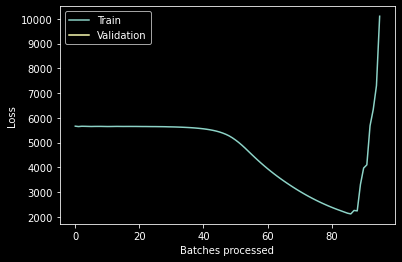

In [2]:
learn.recorder.plot_losses()

In [3]:
learn.fit_one_cycle(5, 2.0892962348E-03 )

epoch,train_loss,valid_loss,detn_l1,detn_lbl,time
0,1203.891968,154.374008,16.505888,137.868118,01:16
1,265.808319,33.818684,12.635726,21.182959,01:08
2,88.798859,32.479641,12.059858,20.419783,01:13
3,50.593620,31.189936,11.391094,19.798843,01:13
4,41.771793,30.567034,11.034285,19.532749,01:10


In [2]:
modelPath = path/'zhr_test'
# learn.save(modelPath/'ssd_basic_noTfms')
# learn.load(modelPath/'ssd_basic_noTfms', strict=True)

In [17]:
x,y = next(iter(data.train_dl))

In [20]:
learn.model.eval()
pred = learn.model(x)

In [21]:
pred[0].shape, pred[1].shape

(torch.Size([64, 189, 4]), torch.Size([64, 189, 21]))

In [19]:
y[0].shape,y[1].shape

(torch.Size([64, 13, 4]), torch.Size([64, 13]))

In [10]:
learn.data.valid_dl.dl.dataset.y.classes

['background',
 'aeroplane',
 'bicycle',
 'bird',
 'boat',
 'bottle',
 'bus',
 'car',
 'cat',
 'chair',
 'cow',
 'diningtable',
 'dog',
 'horse',
 'motorbike',
 'person',
 'pottedplant',
 'sheep',
 'sofa',
 'train',
 'tvmonitor']

In [3]:
anchors = anchors.to('cuda')
def nms(boxes, scores, overlap=0.5, top_k=100):
    keep = scores.new(scores.size(0)).zero_().long()
    if boxes.numel() == 0: return keep
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]
    area = torch.mul(x2 - x1, y2 - y1)
    v, idx = scores.sort(0)  # sort in ascending order
    idx = idx[-top_k:]  # indices of the top-k largest vals
    xx1 = boxes.new()
    yy1 = boxes.new()
    xx2 = boxes.new()
    yy2 = boxes.new()
    w = boxes.new()
    h = boxes.new()

    count = 0
    while idx.numel() > 0:
        i = idx[-1]  # index of current largest val
        keep[count] = i
        count += 1
        if idx.size(0) == 1: break
        idx = idx[:-1]  # remove kept element from view
        # load bboxes of next highest vals
#         import pdb
#         pdb.set_trace()
# https://blog.csdn.net/TonG_L/article/details/115239156 解决此处的报错问题
#         torch.index_select(x1, 0, idx, out=xx1)
#         torch.index_select(y1, 0, idx, out=yy1)
#         torch.index_select(x2, 0, idx, out=xx2)
#         torch.index_select(y2, 0, idx, out=yy2)
        xx1 = torch.index_select(x1, 0, idx)
        yy1 = torch.index_select(y1, 0, idx)
        xx2 = torch.index_select(x2, 0, idx)
        yy2 = torch.index_select(y2, 0, idx)

        # store element-wise max with next highest score
        xx1 = torch.clamp(xx1, min=x1[i])
        yy1 = torch.clamp(yy1, min=y1[i])
        xx2 = torch.clamp(xx2, max=x2[i])
        yy2 = torch.clamp(yy2, max=y2[i])
        w.resize_as_(xx2)
        h.resize_as_(yy2)
        w = xx2 - xx1
        h = yy2 - yy1
        # check sizes of xx1 and xx2.. after each iteration
        w = torch.clamp(w, min=0.0)
        h = torch.clamp(h, min=0.0)
        inter = w*h
        # IoU = i / (area(a) + area(b) - i)
        rem_areas = torch.index_select(area, 0, idx)  # load remaining areas)
        union = (rem_areas - inter) + area[i]
        IoU = inter/union  # store result in iou
        # keep only elements with an IoU <= overlap
        idx = idx[IoU.le(overlap)]
    return keep, count
import numpy as np
# from fastai import *
# from fastai.callbacks import *
# md model这部分很难弄，所以直接放到代码中去

id2cats=learn.data.valid_dl.dl.dataset.y.classes

def get_y(bbox,clas):
    bbox = bbox.view(-1,4)/size
    bb_keep = ((bbox[:,2] - bbox[:,0])>0.).nonzero()[:,0]
    return bbox[bb_keep], clas[bb_keep]
def get1preds(b_clas,b_bb,bbox,clas,thresh=0.25):
    bbox,clas = un_pad(bbox, clas)
    # import pdb
    # pdb.set_trace()
    a_ic = act_to_bbox(b_bb, anchors)# 预测框加上中心偏移 189*4
    clas_pr, clas_ids = b_clas.max(1)
    conf_scores = b_clas.sigmoid().t().data#21*189,第一个类别为0，忽略不计

    out1,out2,cc = [],[],[]
    for cl in range(conf_scores.size(0) - 1):#逐个类别计算
        cl = cl + 1
        cl_mask = conf_scores[cl] > thresh
        if cl_mask.sum() == 0: continue
        scores = conf_scores[cl][cl_mask]#取出这些预测的框的最大类别置信度
        l_mask = cl_mask.unsqueeze(1).expand_as(a_ic)
        boxes = a_ic[l_mask].view(-1, 4)#取出这些锚框，对应的预测框
        ids, count = nms(boxes.data, scores, 0.4, 50)#nms之后，再计算mAP的。
        ids = ids[:count]
        out1.append(scores[ids])
        out2.append(boxes.data[ids])
        cc.append([cl]*count)
    cc = T(np.concatenate(cc)) if cc != [] else None
    out1 = torch.cat(out1) if out1 != [] else None
    out2 = torch.cat(out2) if out2 != [] else None
    return out1,out2,cc

def count(L):
    result = collections.defaultdict(int)
    if L is not None:
        for x in L:
            result[x] += 1
    return result

from ipywidgets import FloatProgress
from IPython.display import display

def multiTPFPFN(md:ImageDataBunch):
    n = 40
    threshes = np.linspace(.05, 0.95, n, endpoint=True)
    tps,fps,fns = np.zeros((n,len(id2cats))),np.zeros((n,len(id2cats))),np.zeros((n,len(id2cats)))
    prog = FloatProgress(min=0,max=len(md.valid_dl))
    display(prog)
    for data in md.train_dl:
        x,y = data
#         x,y = V(x),V(y)
        pred = learn.model(x)#预测结果
        for idx in range(x.size(0)):# batch [bs,img]
            bbox,clas = un_pad(y[0][idx],y[1][idx])#unpad the target
#             import pdb
#             pdb.set_trace()# pred[0]=bbox, pred[1]=clas, pred[0].shape=[189,4], pred[1].shape=[189,21]
            p_scrs,p_box,p_cls = get1preds(pred[1][idx],pred[0][idx],bbox,clas,threshes[0])
            # nms之后，保留下来的框
            overlaps = to_np(jaccard(p_box,bbox.data))
            overlaps = np.where(overlaps > 0.5, overlaps, 0)
#             import pdb
#             pdb.set_trace()
            clas, np_scrs, np_cls = to_np(clas.data),to_np(p_scrs), to_np(p_cls)
            for k in range(threshes.shape[0]):
                new_tp = collections.defaultdict(int)
                for cls in list(set(clas)):# 真实类别
                    msk_clas = np.bitwise_and((clas == cls)[None,:],(np_cls == cls)[:,None])
                    ov_clas = np.where(msk_clas,overlaps,0.)
                    mx_idx = np.argmax(ov_clas,axis=1)
                    for i in range(0,len(clas)):
                        if (clas[i] == cls):
                            keep = np.bitwise_and(np.max(ov_clas,axis=1) > 0.,mx_idx==i)
                            keep = np.bitwise_and(keep,np_scrs > threshes[k])
                            if keep.sum() > 0:
                                new_tp[cls] += 1
                count_pred = count(np_cls[np_scrs > threshes[k]])
                count_gt = count(clas)
                for c in range(len(id2cats)):
                    tps[k,c] += new_tp[c]
                    fps[k,c] += count_pred[c] - new_tp[c]
                    fns[k,c] += count_gt[c] - new_tp[c]
        prog.value += 1
    return tps, fps, fns

class mAP():
    def __init__(self, md:ImageDataBunch):
        self.md = md
        self.mAP = 0.0
    def plot_prec_recall(self, clas, ax=None):
        tps = self.tps
        fps = self.fps
        fns = self.fns
        prec = np.where(tps[:,clas] + fps[:,clas] != 0, tps[:,clas]/(tps[:,clas] + fps[:,clas]), 1)
        recal = np.where(tps[:,clas] + fns[:,clas] != 0, tps[:,clas]/(tps[:,clas] + fns[:,clas]), 1)
        if ax is None:
            plt.plot(recal,prec)
        else:
            ax.plot(recal, prec)

    def avg_prec(self, clas):
        tps = self.tps
        fps = self.fps
        fns = self.fns
        precisions = np.where(tps[:,clas] + fps[:,clas] != 0, tps[:,clas]/(tps[:,clas] + fps[:,clas]), 1)
        recalls = np.where(tps[:,clas] + fns[:,clas] != 0, tps[:,clas]/(tps[:,clas] + fns[:,clas]), 1)
        prec_at_rec = []
        for recall_level in np.linspace(0.0, 1.0, 11):
            try:
                args = np.argwhere(recalls >= recall_level).flatten()
                prec = max(precisions[args])
            except ValueError:
                prec = 0.0
            prec_at_rec.append(prec)
        return np.array(prec_at_rec).mean()
    def calculate(self):
        learn.model.eval()
        self.tps, self.fps, self.fns = multiTPFPFN(self.md)#先计算各个类别的tp,fp,fn
        S = 0
        for i in range(len(id2cats)):
            S += self.avg_prec(i)
        self.mAP = S/len(id2cats)
        print(self.mAP)

def intersection(box_a,box_b):
    min_xy = torch.max(box_a[:,None,:2],box_b[None,:,:2])
    max_xy = torch.min(box_a[:,None,2:],box_b[None,:,2:])
    inter = torch.clamp(max_xy-min_xy,min=0)
    return inter[:,:,0] * inter[:,:,1]

def get_size(box):
    return (box[:,2]-box[:,0]) * (box[:,3] - box[:,1])

def jaccard(box_a,box_b):
    inter = intersection(box_a,box_b)
    union = get_size(box_a).unsqueeze(1) + get_size(box_b).unsqueeze(0) - inter
    return inter/union
def T(a, half=False, cuda=True):
    """
    Convert numpy array into a pytorch tensor. 
    if Cuda is available and USE_GPU=True, store resulting tensor in GPU.
    """
    if not torch.is_tensor(a):
        a = np.array(np.ascontiguousarray(a))
        if a.dtype in (np.int8, np.int16, np.int32, np.int64):
            a = torch.LongTensor(a.astype(np.int64))
        elif a.dtype in (np.float32, np.float64):
            a = to_half(a) if half else torch.FloatTensor(a)
        else: raise NotImplementedError(a.dtype)
    if cuda:
        a = to_gpu(a)
    return a
def to_gpu(x, *args, **kwargs):
    '''puts pytorch variable to gpu, if cuda is available and USE_GPU is set to true. '''
    return x.cuda(*args, **kwargs) if True else x

In [4]:
anchors = anchors.to(device)
size = sz # batch_size
mAP_metric = mAP(data)
mAP_metric.calculate()
# learn.save(path/'ssd_basic')

FloatProgress(value=0.0, max=2.0)

0.1853160589092128


In [23]:
# learn.model.body
# learn.layer_groups[2]# head
learn.layer_groups[1] # m.body[6],前面6层冻结起来了。128变256，18*28的featuremap的时候

Sequential(
  (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
  (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): Conv2d(128, 256, kernel_size=(1, 1), stride=(2, 2), bias=False)
  (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (9): ReLU(inplace=True)
  (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (11): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1),

In [15]:
learn.layer_groups[-2:]# 第一次freeze()只到-1，即只有后面的head训练
# 这个freeze_to(-2)是前面的第二个层要一起训练的。共3个layer_groups

[Sequential(
   (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
   (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (2): ReLU(inplace=True)
   (3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (5): Conv2d(128, 256, kernel_size=(1, 1), stride=(2, 2), bias=False)
   (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (7): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (9): ReLU(inplace=True)
   (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
   (11): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), p

epoch,train_loss,valid_loss,detn_l1,detn_lbl,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


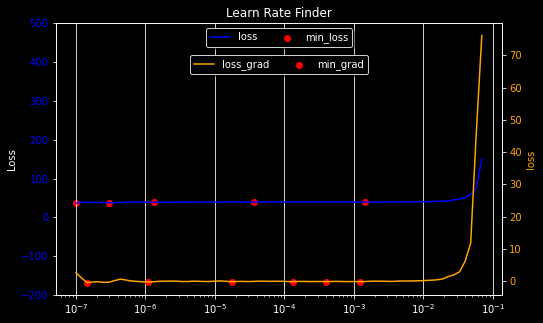

Model set to: "unfreeze" or "freeze_to:"
                   *Gradient - Orange Graph*  *Loss - Blue Graph*
First choice lr:            1.2022644514E-03     1.4454397606E-03
Second choice lr:           3.9810716407E-04     3.6307807022E-05
Third choice lr:            1.3182566909E-04     1.3182567500E-06


In [5]:
learn.load(modelPath/'ssd_basic_noTfms', strict=True)

learn.split(lambda m: (m.body[6],m.drop))
learn.freeze_to(-2)# body的一半开放来进行训练，开始训练预训练权重的部分了
learn.lr_find()
lr = find_optimal_lr(learn)

# anchors = anchors.to('cpu')
# # Get batch from valid dataset
# xb,yb = next(iter(learn.data.valid_dl))
# xb.shape

# # Predict results based on the input image batch
# learn.model.eval()

In [24]:
learn.fit_one_cycle(10, slice(1e-5, 1.4454397606E-03))#slice(a,b) a为unfreeze()后loss下降最快的lr，b为freeze()前lr的1/10

epoch,train_loss,valid_loss,detn_l1,detn_lbl,time
0,38.353352,28.944574,10.236762,18.707813,01:30
1,36.269363,27.365610,9.238622,18.126987,01:25
2,33.657848,25.576143,8.996705,16.579439,01:22
3,30.947626,23.260269,8.304614,14.955655,01:23
4,27.919861,22.018757,8.030859,13.987897,01:24
5,25.467108,20.436274,7.210878,13.225395,01:23
6,23.221422,19.514175,6.601095,12.913081,01:24
7,21.643806,18.947399,6.340195,12.607204,01:24
8,20.181740,18.704592,6.140118,12.564472,01:22
9,19.502060,18.570320,6.080271,12.490048,01:25


In [4]:
# learn.save(modelPath/'ssd_freeze_2_1')
modelPath = path/'zhr_test'
learn.load(modelPath/'ssd_freeze_2_1', strict=True)

Learner(data=ImageDataBunch;

Train: LabelList (4911 items)
x: ObjectItemList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: ObjectCategoryList
ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224)
Path: /home/helen/dataset/pascal_2007/train;

Valid: LabelList (100 items)
x: ObjectItemList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: ObjectCategoryList
ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224)
Path: /home/helen/dataset/pascal_2007/train;

Test: None, model=ssd_model(
  (body): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mod

In [29]:
anchors = anchors.to(device)
mAP_metric2 = mAP(data)
mAP_metric2.calculate()

FloatProgress(value=0.0, max=2.0)

0.42272667406402986


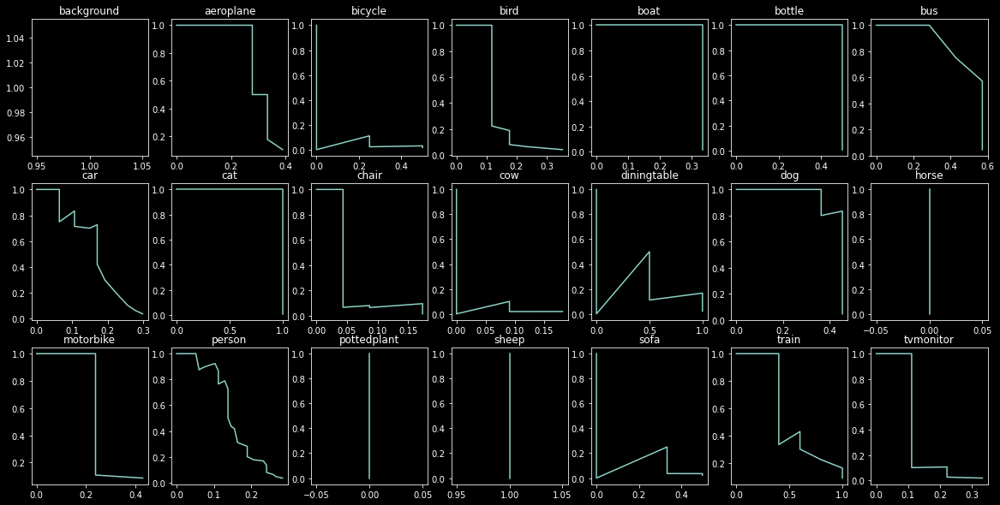

In [27]:
fig, axes = plt.subplots(3,7, figsize=(20,10))
axes_list = []
for i in range(axes.shape[0]):
    for j in range(axes.shape[1]):
        axes_list.append(axes[i,j])
i = 0
for ax in axes_list:
    mAP_metric2.plot_prec_recall(i, ax)
    # print(id2cats[idx])
    ax.set_title(id2cats[i])
    i += 1
# 横轴recall,纵轴precision。随着阈值的增大，recall降低，精度增加；阈值减小，右下角，recall增加，但精度减小。
"""
① boat、bottle、cat，dog基本全找出来了。
② pottleplant, horse基本都没找出来。
③ cow牛也找的不行；

"""

In [29]:
mAP_metric2.tps.shape

(40, 20)

In [4]:
learn.model.eval()
xb, yb = next(iter(learn.data.valid_dl))
# anchors = anchors.to('cpu')

preds = learn.model(xb)
b_bb, b_clas = preds
def show_img_by_ndx(idx):
    t_bbox,t_clas = un_pad(yb[0][idx],yb[1][idx])
    p_cls_test = preds[1][idx][:,1:].max(dim=1)
    idx_clas = p_cls_test[0].sigmoid() > 0.1
    p_f_clas = (p_cls_test[1] + 1) * (idx_clas).long()
    img = vision.Image(denormalize(xb[idx],*tensor(imagenet_stats)))
    img_box = ImageBBox.create(224,224,yb[0][idx].cpu(),labels=yb[1][idx],classes=data.classes,scale=False)


    p_final_bbox = act_to_bbox(preds[0][idx].cpu(),anchors)
    t_bbox = p_final_bbox.to(device).index_select(dim=0,index=idx_clas.nonzero().squeeze())
    test_clas = p_f_clas.index_select(dim=0,index=idx_clas.nonzero().squeeze())
    p_img_box = ImageBBox.create(224,224,t_bbox.detach().cpu(),test_clas.detach().cpu(),classes=data.classes,scale=False)

    fig,axes = plt.subplots(1,2,figsize=(10,6))
#     import pdb
#     pdb.set_trace()
    img.show(ax=axes[0],y=img_box,title='Ground Truth')
    img.show(ax=axes[1],y=p_img_box,title='Prediction')

# show_img_by_ndx(2)

Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty. Image may be too faint.
Inferred Class list is empty

IndexError: index 64 is out of bounds for dimension 0 with size 64

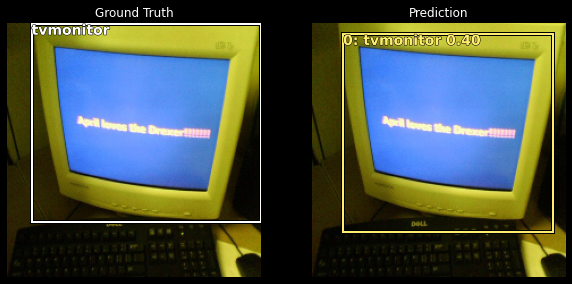

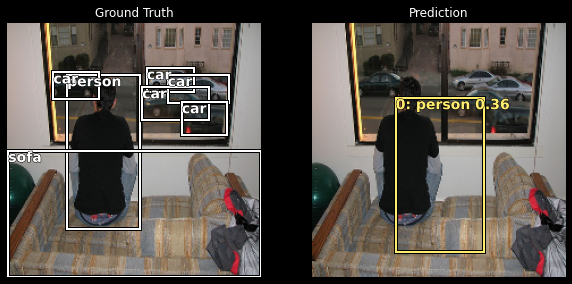

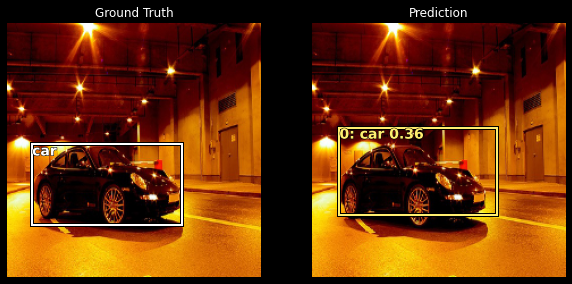

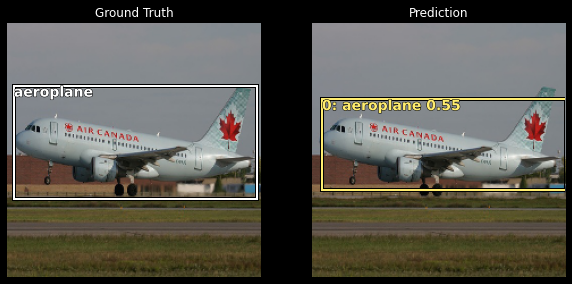

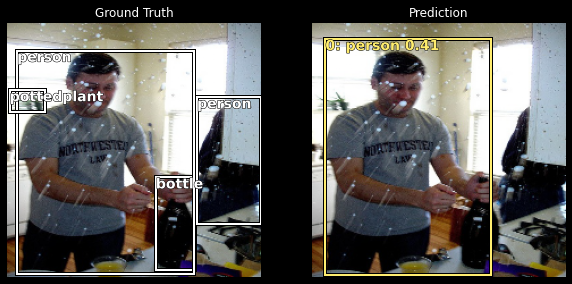

...

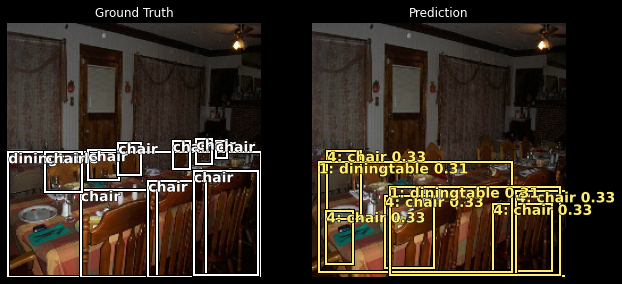

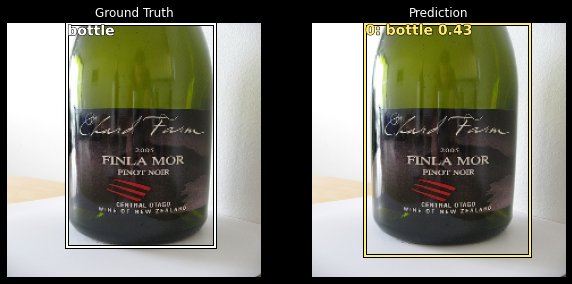

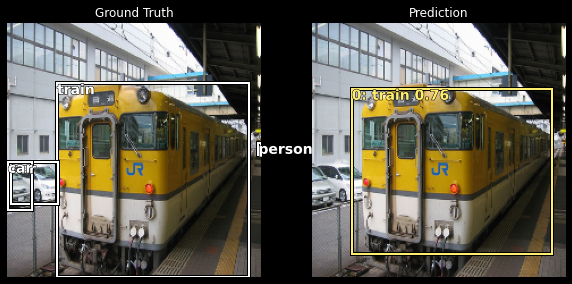

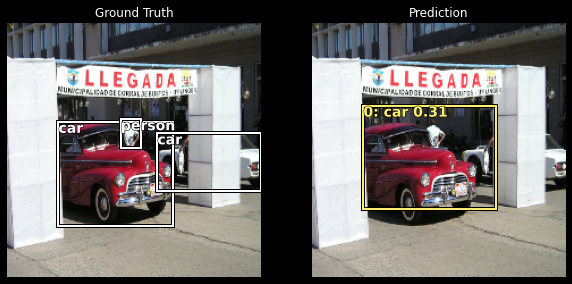

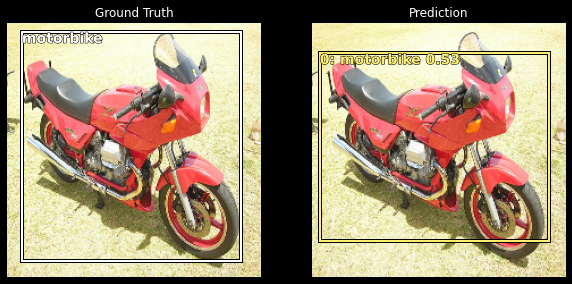

In [7]:
anchors = anchors.to('cpu')
import matplotlib.cm as cmx
import matplotlib.colors as mcolors
from cycler import cycler

def get_cmap(N):
    color_norm  = mcolors.Normalize(vmin=0, vmax=N-1)
    return cmx.ScalarMappable(norm=color_norm, cmap='Set3').to_rgba

num_colr = 12
cmap = get_cmap(num_colr)
colr_list = [cmap(float(x)) for x in range(num_colr)]

def process_nmf(idx):
    '''
    Connects to the nmf algorith to filter out dupplicate bounding boxes
    ''' 
    # Minimun threshold for eliminating background noise
    min_thresh = 0.30     #0.25 
    # Maximun threshold for eliminating duplicate boxes
    max_thresh = 0.1  
    # Extract predicted classes
    clas_pr, clas_ids = b_clas[idx].max(dim=1)
    
    # Mask Index of classes whose contents are over the noise level: 0 if the index contains no boxes, 1 if it does
    clas_pr = clas_pr.sigmoid()    
    
    # Calculate confidence score for Class Activations
    conf_scores = b_clas[idx].sigmoid().t().data  
    
    # Converts activation vectors to boxes. Shape: 189 x 4
    p_final_bbox = act_to_bbox(preds[0][idx].cpu(),anchors) 
    
    # lists for accumulating selected boxes and classes
    tot_bx, tot_cls = [], []
    
    scrd_cls_lst = data.classes.copy()
  
    # Loop across all classes
    for cl in range(0, len(conf_scores)):
        
        # Filter out Backgrounds and empty box arrays
        c_mask = conf_scores[cl] > min_thresh
        if c_mask.sum() == 0 or cl == 0: continue
        # scores for the selected class 
        scores = conf_scores[cl][c_mask] # Tensor 
            
        # These are active boxes. Ready to be processed by nmf
        boxes = p_final_bbox.to(device).index_select(dim=0,index=c_mask.nonzero().squeeze())
            
        # Run NMF
        ids, count = nms(boxes.data, scores, overlap=0.5, top_k=50)
        ids = ids[:count]
        
        # Filter all boxes & classes over the threshold and accumulate them in lists
        for i, (sc, bx) in enumerate(zip(scores, boxes.data[ids] )): 
                 
            tot_bx.append(bx)
            tot_cls.append(cl)
            # Create a scored label
            f = f'{i}: '           
            l = f'{data.classes[cl]} '
            s = '{0:.2f}'.format(sc) 
            sl = f+l+s
            # print('scored label: {} '.format(sl))
            scrd_cls_lst[cl] = sl

                
    if not tot_cls:
        print('Inferred Class list is empty. Image may be too faint.')
        return None, None, None  
    
    return torch.cat(tot_bx).view(-1, 4), torch.tensor((np.array(tot_cls))), scrd_cls_lst

# Filter Single Image
def show_filtered_img_by_ndx(idx):
    # Prepare ground-truth image for display
    img = vision.Image(denormalize(xb[idx],*tensor(imagenet_stats)))        
    img_box = ImageBBox.create(224,224,yb[0][idx].cpu(),labels=yb[1][idx],classes=data.classes,scale=False)
    
    # Unpad Y (ground-truth boxes and classes )
    t_bbox,t_clas = un_pad(yb[0][idx],yb[1][idx])
     
    # Process NMF 
    tot_bx, tot_cls, scrd_cls_lst = process_nmf(idx)  # Filter dupplicate boxes
    if tot_bx is None: return 
    
    # Compose the image, bouding boxes, ans classes for display
    p_img_box = ImageBBox.create(224,224,tot_bx.cpu(),tot_cls.cpu(),classes=scrd_cls_lst,scale=False)
  
    # Display resulting image, selected bounding boxes, and class labels
    fig,axes = plt.subplots(1,2,figsize=(10,6))
    img.show(ax=axes[0],y=img_box,title='Ground Truth')
    img.show(ax=axes[1],y=p_img_box,title='Prediction', color=colr_list[11])
   
# show_filtered_img_by_ndx(75)
for i in range(1,sz):
    show_filtered_img_by_ndx(i)

In [5]:
learn.split(lambda m:(m.body[6], m.drop))
learn.freeze_to(-2)
# learn.lr_find()
# lr = find_optimal_lr(learn)

In [6]:
anchors = anchors.to(device)
learn.fit_one_cycle(10, slice(1.5848931798E-04))

epoch,train_loss,valid_loss,detn_l1,detn_lbl,time
0,19.145912,18.614483,6.096999,12.517483,01:38
1,19.167381,18.484861,6.013114,12.471745,01:37
2,19.023577,18.530235,6.078670,12.451565,01:39
3,18.746456,18.650057,6.124604,12.525453,01:38
4,18.386957,18.562843,6.023492,12.539351,01:38
5,18.021265,18.542057,6.013297,12.528760,01:38
6,17.690699,18.637957,6.076961,12.560996,01:38
7,17.278046,18.546225,5.981980,12.564244,01:38
8,17.234709,18.575333,6.050672,12.524662,01:37
9,17.078615,18.515467,6.007882,12.507586,01:38


In [4]:
modelPath = path/'zhr_test'
# learn.save(modelPath/'ssd_freeze_2_2')
learn.load(modelPath/'ssd_freeze_2_2', strict=True)

Learner(data=ImageDataBunch;

Train: LabelList (4911 items)
x: ObjectItemList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: ObjectCategoryList
ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224)
Path: /home/helen/dataset/pascal_2007/train;

Valid: LabelList (100 items)
x: ObjectItemList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: ObjectCategoryList
ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224),ImageBBox (224, 224)
Path: /home/helen/dataset/pascal_2007/train;

Test: None, model=ssd_model(
  (body): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mod

In [8]:
anchors = anchors.to(device)
mAP_metric2 = mAP(data)
mAP_metric2.calculate()

FloatProgress(value=0.0, max=2.0)

0.4250726185888977


In [5]:
anchors = anchors.to(device)
mAP_metric2 = mAP(data)
mAP_metric2.calculate()#train_dl，0.34

FloatProgress(value=0.0, max=2.0)

0.34741353020119903
